In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

# KAGGLE_TRAIN_PATH = '/kaggle/input/stanford-cars-dataset/cars_train/cars_train'
# KAGGLE_TEST_PATH = '/kaggle/input/stanford-cars-dataset/cars_test/cars_test'

KAGGLE_TRAIN_PATH = '/kaggle/input/animal-dataset/animal_dataset_intermediate/train/elefante_train'
KAGGLE_TEST_PATH = '/kaggle/input/animal-dataset/animal_dataset_intermediate/test'

WINDOWS_TRAIN_PATH = r'C:\Users\dndlssardar\OneDrive - Smiths Group\Documents\Projects\Diffusion\animal_dataset_intermediate\train\elefante_train'
WINDOWS_TEST_PATH = r'C:\Users\dndlssardar\OneDrive - Smiths Group\Documents\Projects\Diffusion\animal_dataset_intermediate\test\elephant'

LINUX_TRAIN_PATH = '/mnt/c/Users/dndlssardar/OneDrive - Smiths Group/Documents/Projects/Diffusion/animal_dataset_intermediate/train/elefante_train'
LINUX_TEST_PATH = '/mnt/c/Users/dndlssardar/OneDrive - Smiths Group/Documents/Projects/Diffusion/animal_dataset_intermediate/test/elephant'


TRAIN_DATASET_PATH = LINUX_TRAIN_PATH
TEST_DATASET_PATH = LINUX_TEST_PATH

In [2]:
os.path.exists(TRAIN_DATASET_PATH)

True

References: https://www.youtube.com/watch?v=a4Yfz2FxXiY&t=129s
# A Diffusion Model from Scratch in Pytorch

In this notebook I want to build a very simple (as few code as possible) Diffusion Model for generating car images. I will explain all the theoretical details in the YouTube video. 


**Sources:**
- Github implementation [Denoising Diffusion Pytorch](https://github.com/lucidrains/denoising-diffusion-pytorch)
- Niels Rogge, Kashif Rasul, [Huggingface notebook](https://colab.research.google.com/github/huggingface/notebooks/blob/main/examples/annotated_diffusion.ipynb#scrollTo=3a159023)
- Papers on Diffusion models ([Dhariwal, Nichol, 2021], [Ho et al., 2020] ect.)


## Investigating the dataset

As dataset we use the StandordCars Dataset, which consists of around 8000 images in the train set. Let's see if this is enough to get good results ;-)

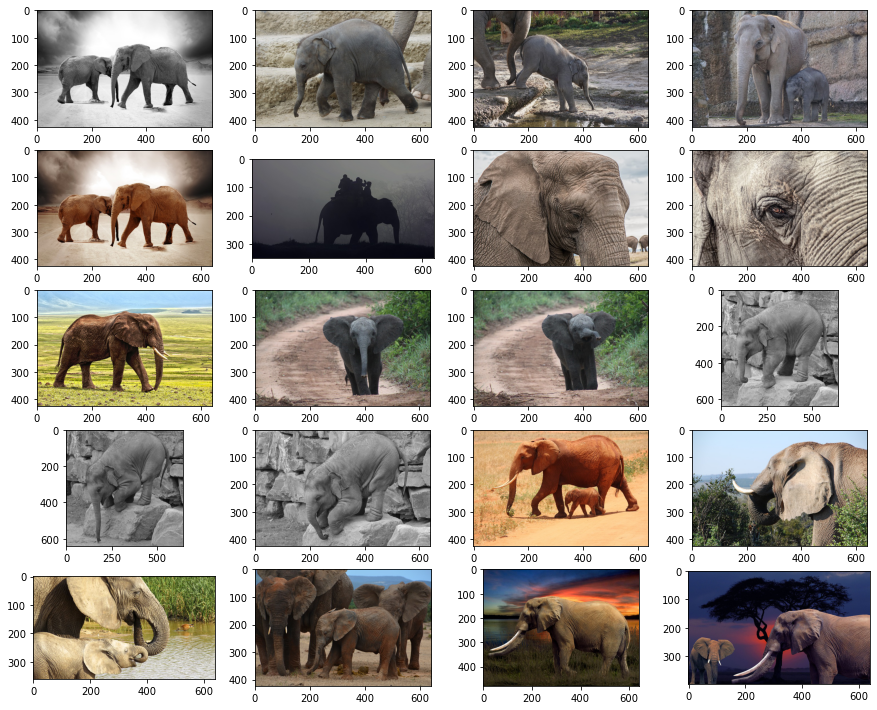

In [3]:
import torch
import torchvision
import matplotlib.pyplot as plt
import ast
import os
from collections import defaultdict
import random
import cv2
import numpy as np
import pandas as pd
import torch
from PIL import Image
from torch.utils.data import Dataset
from torchvision.transforms import transforms

def show_images(dataset, num_samples=20, cols=4):
    """ Plots some samples from the dataset """
    plt.figure(figsize=(15,15)) 
    for i, img in enumerate(dataset):
        if i == num_samples:
            break
        plt.subplot(num_samples//cols + 1, cols, i + 1)
        plt.imshow(img)


# 
class MyDataset(Dataset):
    
    def __init__(self, path, transform=None, device='cpu'):
        self.filenames = [os.path.join(path, filename) for filename in os.listdir(path) if '.txt' not in filename]
        self.transform = transform
        self.device = device
    
    def __len__(self):
        return len(self.filenames)
    
    def __getitem__(self, idx):
        img_path = self.filenames[idx]
        imagePIL = Image.open(img_path).convert('RGB')
        
        # transform image
        if self.transform:
            tensor_img = self.transform(imagePIL)
            return tensor_img.to(self.device)
        else:
            return imagePIL
        
dataset = MyDataset(path=TEST_DATASET_PATH)
show_images(dataset)

Later in this notebook we will do some additional modifications to this dataset, for example make the images smaller, convert them to tensors ect. 

## Step 1: The forward process = Noise scheduler

We first need to build the inputs for our model, which are more and more noisy images. Instead of doing this sequentially, we can use the closed form provided in the papers to calculate the image for any of the timesteps individually. 

**Key Takeaways**:
- The noise-levels/variances can be pre-computed
- There are different types of variance schedules
- We can sample each timestep image independently (Sums of Gaussians is also Gaussian)
- No model is needed in this forward step

In [4]:
import torch.nn.functional as F

def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
    """
    Linear noise(beta) schedular
    """
    return torch.linspace(start, end, timesteps)

def get_index_from_list(vals, t, x_shape):
    """ 
    Returns a specific index t of a passed list of values vals
    while considering the batch dimension.
    """
    batch_size = t.shape[0]
    out = vals.gather(-1, t.cpu())
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)

def forward_diffusion_sample(x_0, t, device="cpu"):
    """ 
    Takes an image and a timestep as input and 
    returns the noisy version of it
    """
    noise = torch.randn_like(x_0)
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x_0.shape
    )
    # mean + variance
#     print("forward_diffusion_sample-1:",sqrt_alphas_cumprod.shape,t.shape,
#           sqrt_one_minus_alphas_cumprod.shape,
#           sqrt_alphas_cumprod_t.shape, 
#           x_0.shape)
    mean = sqrt_alphas_cumprod_t.to(device) * x_0.to(device)
    variance = sqrt_one_minus_alphas_cumprod_t.to(device) * noise.to(device)
    return  mean + variance, noise.to(device)


# Define beta schedule
T = 300
betas = linear_beta_schedule(timesteps=T)

# Pre-calculate different terms for closed form
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)

In [5]:
from torchvision import transforms 
from torch.utils.data import DataLoader
import numpy as np

IMG_SIZE = 64
BATCH_SIZE = 128

def load_transformed_dataset():
    data_transforms = [
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(), # Scales data into [0,1] 
        transforms.Lambda(lambda t: (t * 2) - 1) # Scale between [-1, 1] 
    ]
    data_transform = transforms.Compose(data_transforms)
    
    train = MyDataset(path=TRAIN_DATASET_PATH, transform=data_transform)
    test = MyDataset(path=TEST_DATASET_PATH, transform=data_transform)

    
#     train = torchvision.datasets.StanfordCars(root=".", download=True, 
#                                          transform=data_transform)

#     test = torchvision.datasets.StanfordCars(root=".", download=True, 
#                                          transform=data_transform, split='test')
    
    return torch.utils.data.ConcatDataset([train, test])
def show_tensor_image(image):
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),
        transforms.Lambda(lambda t: t.permute(1, 2, 0)), # CHW to HWC
        transforms.Lambda(lambda t: t * 255.),
        transforms.Lambda(lambda t: t.numpy().astype(np.uint8)),
        transforms.ToPILImage(),
    ])

    # Take first image of batch
    if len(image.shape) == 4:
        image = image[0, :, :, :] 
    plt.imshow(reverse_transforms(image))

data = load_transformed_dataset()
dataloader = DataLoader(data, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)

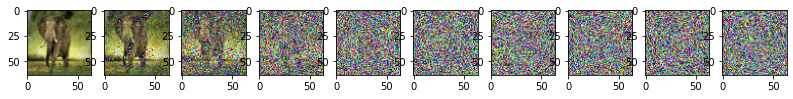

In [6]:
# Simulate forward diffusion
image = next(iter(dataloader))[0]

plt.figure(figsize=(15,15))
plt.axis('off')
num_images = 10
stepsize = int(T/num_images)

for idx in range(0, T, stepsize):
    t = torch.Tensor([idx]).type(torch.int64)
    plt.subplot(1, num_images+1, (idx//stepsize) + 1)
    image, noise = forward_diffusion_sample(image, t)
    show_tensor_image(image)

## Step 2: The backward process = U-Net

For a great introduction to UNets, have a look at this post: https://amaarora.github.io/2020/09/13/unet.html.


**Key Takeaways**:
- We use a simple form of a UNet for to predict the noise in the image
- The input is a noisy image, the ouput the noise in the image
- Because the parameters are shared accross time, we need to tell the network in which timestep we are
- The Timestep is encoded by the transformer Sinusoidal Embedding
- We output one single value (mean), because the variance is fixed


In [7]:
from torch import nn
import math


class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4, 2, 1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()
        
    def forward(self, x, t, ):
        # First Conv
        h = self.bnorm1(self.relu(self.conv1(x)))
        # Time embedding
        time_emb = self.relu(self.time_mlp(t))
        # Extend last 2 dimensions
        time_emb = time_emb[(..., ) + (None, ) * 2]
        # Add time channel
        h = h + time_emb
        # Second Conv
        h = self.bnorm2(self.relu(self.conv2(h)))
        # Down or Upsample
        return self.transform(h)


class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2
        embeddings = math.log(10000) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        # TODO: Double check the ordering here
        return embeddings


class SimpleUnet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    """
    def __init__(self):
        super().__init__()
        image_channels = 3
        down_channels = (64, 128, 256, 512, 1024)
        up_channels = (1024, 512, 256, 128, 64)
        out_dim = 1 
        time_emb_dim = 32

        # Time embedding
        self.time_mlp = nn.Sequential(
                SinusoidalPositionEmbeddings(time_emb_dim),
                nn.Linear(time_emb_dim, time_emb_dim),
                nn.ReLU()
            )
        
        # Initial projection
        self.conv0 = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)

        # Downsample
        self.downs = nn.ModuleList([Block(down_channels[i], down_channels[i+1], time_emb_dim)
                        for i in range(len(down_channels)-1)])
        # Upsample
        self.ups = nn.ModuleList([Block(up_channels[i], up_channels[i+1], time_emb_dim, up=True)
                        for i in range(len(up_channels)-1)])

        self.output = nn.Conv2d(up_channels[-1], 3, out_dim)

    def forward(self, x, timestep):
        # Embedd time
        t = self.time_mlp(timestep)
        # Initial conv
        x = self.conv0(x)
        # Unet
        residual_inputs = []
        for down in self.downs:
            x = down(x, t)
            residual_inputs.append(x)
        for up in self.ups:
            residual_x = residual_inputs.pop()
            # Add residual x as additional channels
            x = torch.cat((x, residual_x), dim=1)           
            x = up(x, t)
        return self.output(x)

model = SimpleUnet()
print("Num params: ", sum(p.numel() for p in model.parameters()))
model

Num params:  62438883


SimpleUnet(
  (time_mlp): Sequential(
    (0): SinusoidalPositionEmbeddings()
    (1): Linear(in_features=32, out_features=32, bias=True)
    (2): ReLU()
  )
  (conv0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (downs): ModuleList(
    (0): Block(
      (time_mlp): Linear(in_features=32, out_features=128, bias=True)
      (conv1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transform): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bnorm1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (bnorm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
    )
    (1): Block(
      (time_mlp): Linear(in_features=32, out_features=256, bias=True)
      (conv1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transfor


**Further improvements that can be implemented:**
- Residual connections
- Different activation functions like SiLU, GWLU, ...
- BatchNormalization 
- GroupNormalization
- Attention
- ...

## Step 3: The loss

**Key Takeaways:**
- After some maths we end up with a very simple loss function
- There are other possible choices like L2 loss ect.


In [8]:
def get_loss(model, x_0, t):
    # print("get_loss",x_0.shape)
    x_noisy, noise = forward_diffusion_sample(x_0, t, device)
    noise_pred = model(x_noisy, t)
    return F.l1_loss(noise, noise_pred)

## Sampling
- Without adding @torch.no_grad() we quickly run out of memory, because pytorch tacks all the previous images for gradient calculation 
- Because we pre-calculated the noise variances for the forward pass, we also have to use them when we sequentially perform the backward process

In [9]:
@torch.no_grad()
def sample_timestep(x, t):
    """
    Calls the model to predict the noise in the image and returns 
    the denoised image. 
    Applies noise to this image, if we are not in the last step yet.
    """
    betas_t = get_index_from_list(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x.shape
    )
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)
    
    # Call model (current image - noise prediction)
    model_mean = sqrt_recip_alphas_t * (
        x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t
    )
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)
    
    if t == 0:
        return model_mean
    else:
        noise = torch.randn_like(x)
        return model_mean + torch.sqrt(posterior_variance_t) * noise 

@torch.no_grad()
def sample_plot_image():
    # Sample noise
    img_size = IMG_SIZE
    img = torch.randn((1, 3, img_size, img_size), device=device)
    plt.figure(figsize=(15,15))
    plt.axis('off')
    num_images = 10
    stepsize = int(T/num_images)

    for i in range(0,T)[::-1]:
        t = torch.full((1,), i, device=device, dtype=torch.long)
        img = sample_timestep(img, t)
        if i % stepsize == 0:
            plt.subplot(1, num_images, i//stepsize+1)
            show_tensor_image(img.detach().cpu())
    plt.show()

## Training Loop

In [10]:
torch.cuda.is_available()

True

Epoch 0 | step 010 Loss: 0.47240203619003296 


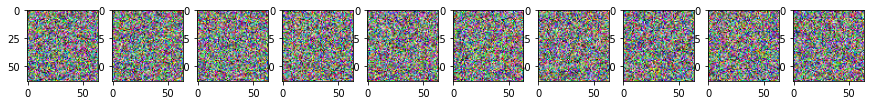

Epoch 5 | step 010 Loss: 0.3016497492790222 


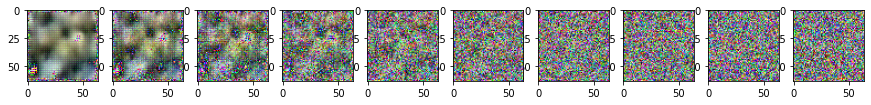

Epoch 10 | step 010 Loss: 0.23803651332855225 


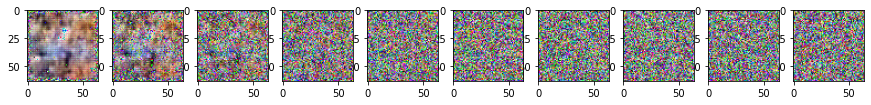

Epoch 15 | step 010 Loss: 0.2014501392841339 


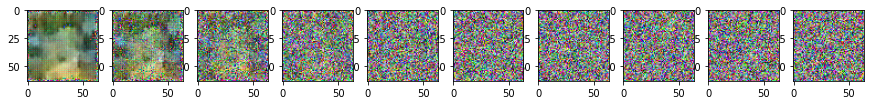

Epoch 20 | step 010 Loss: 0.18226107954978943 


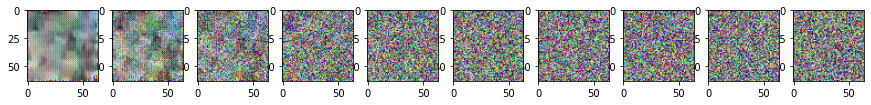

Epoch 25 | step 010 Loss: 0.19994203746318817 


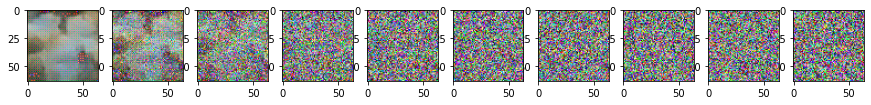

Epoch 30 | step 010 Loss: 0.16163980960845947 


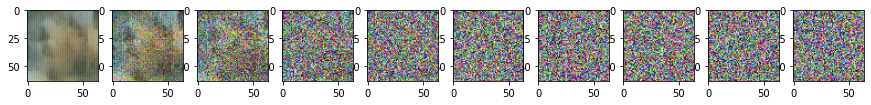

Epoch 35 | step 010 Loss: 0.17434000968933105 


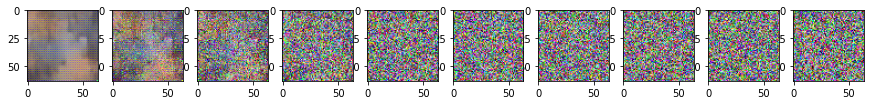

Epoch 40 | step 010 Loss: 0.1652633249759674 


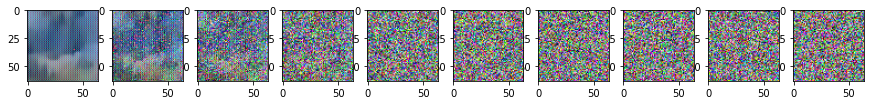

Epoch 45 | step 010 Loss: 0.15193824470043182 


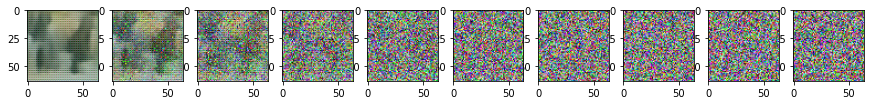

Epoch 50 | step 010 Loss: 0.16357392072677612 


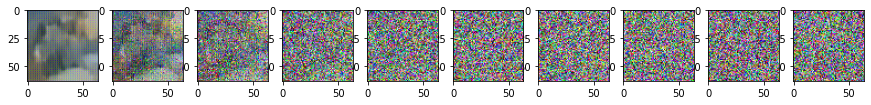

Epoch 55 | step 010 Loss: 0.15689095854759216 


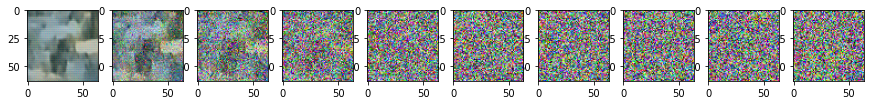

Epoch 60 | step 010 Loss: 0.15325042605400085 


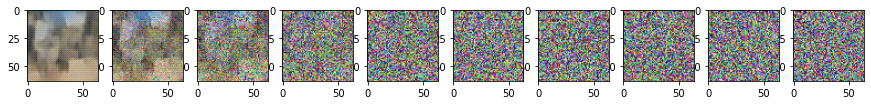

Epoch 65 | step 010 Loss: 0.3805769383907318 


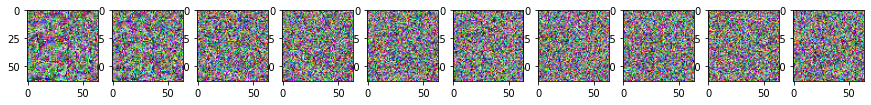

Epoch 70 | step 010 Loss: 0.18575815856456757 


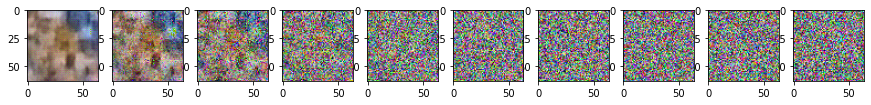

Epoch 75 | step 010 Loss: 0.21959662437438965 


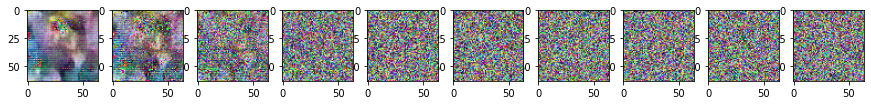

Epoch 80 | step 010 Loss: 0.18746952712535858 


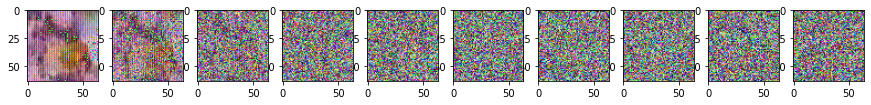

Epoch 85 | step 010 Loss: 0.16316789388656616 


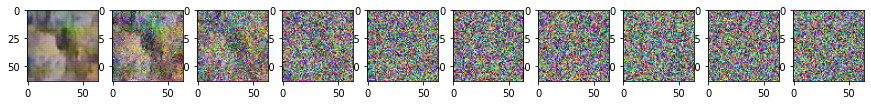

Epoch 90 | step 010 Loss: 0.15779338777065277 


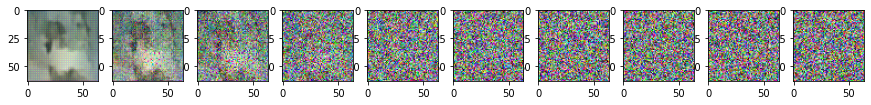

Epoch 95 | step 010 Loss: 0.15613412857055664 


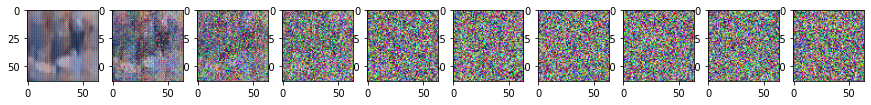

Epoch 100 | step 010 Loss: 0.15070335566997528 


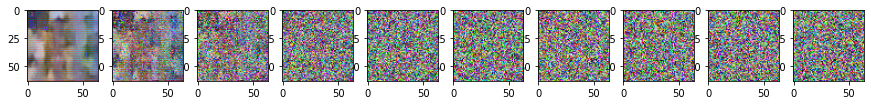

Epoch 105 | step 010 Loss: 0.1679907739162445 


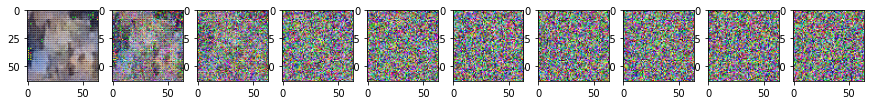

Epoch 110 | step 010 Loss: 0.1551622599363327 


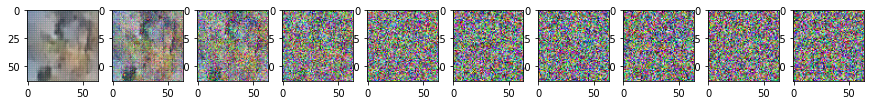

Epoch 115 | step 010 Loss: 0.15986678004264832 


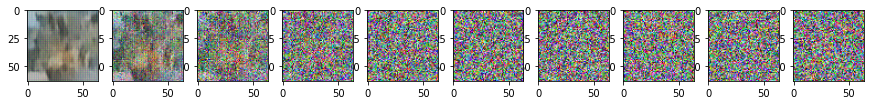

Epoch 120 | step 010 Loss: 0.14431093633174896 


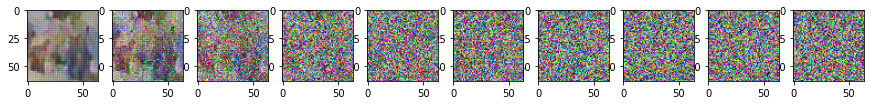

Epoch 125 | step 010 Loss: 0.16585782170295715 


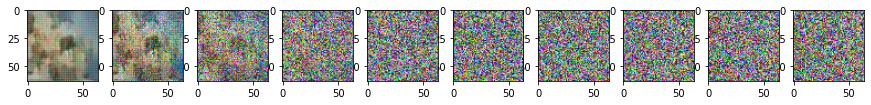

Epoch 130 | step 010 Loss: 0.14403840899467468 


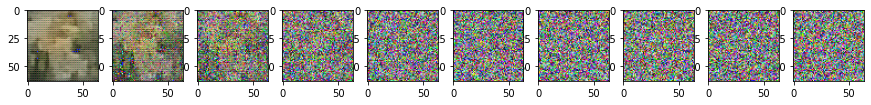

Epoch 135 | step 010 Loss: 0.1626354455947876 


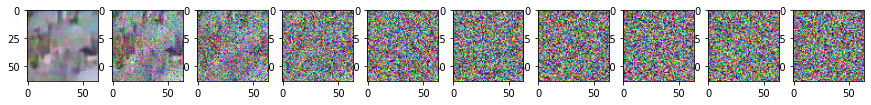

Epoch 140 | step 010 Loss: 0.15357705950737 


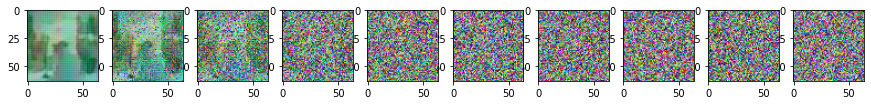

Epoch 145 | step 010 Loss: 0.16080030798912048 


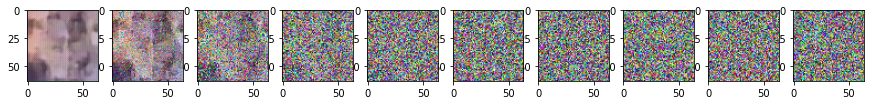

Epoch 150 | step 010 Loss: 0.13806560635566711 


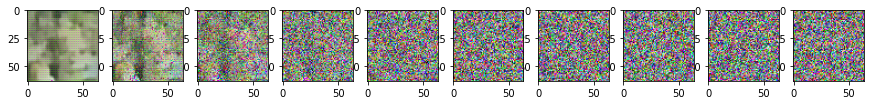

Epoch 155 | step 010 Loss: 0.14363017678260803 


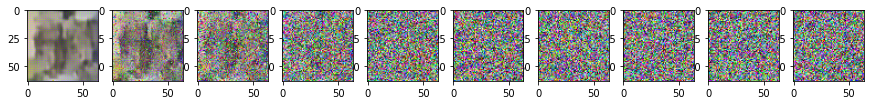

Epoch 160 | step 010 Loss: 0.15733811259269714 


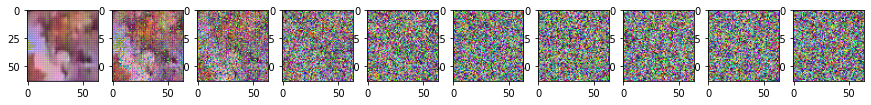

Epoch 165 | step 010 Loss: 0.15185469388961792 


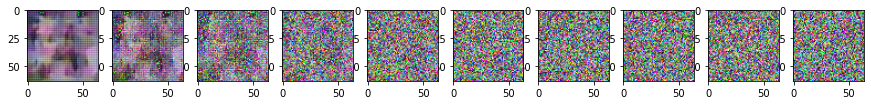

Epoch 170 | step 010 Loss: 0.15731191635131836 


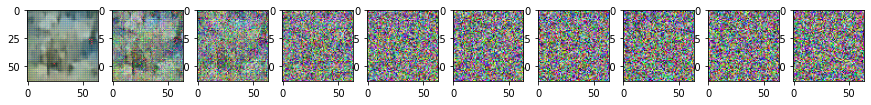

Epoch 175 | step 010 Loss: 0.15489380061626434 


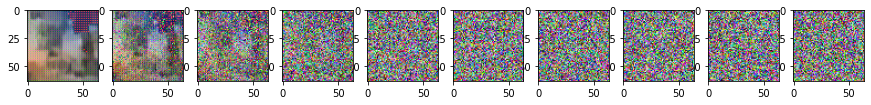

Epoch 180 | step 010 Loss: 0.1566605269908905 


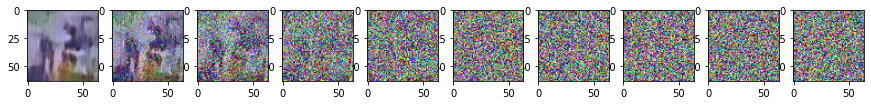

Epoch 185 | step 010 Loss: 0.14575199782848358 


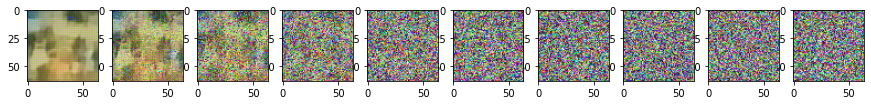

Epoch 190 | step 010 Loss: 0.17235684394836426 


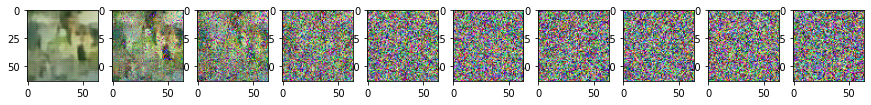

Epoch 195 | step 010 Loss: 0.1753319501876831 


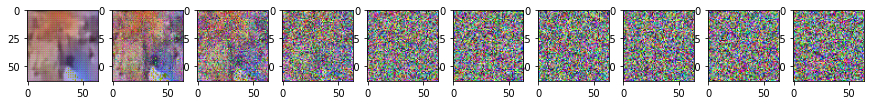

Epoch 200 | step 010 Loss: 0.1541818082332611 


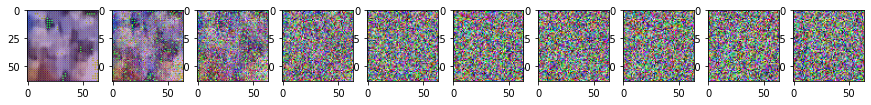

Epoch 205 | step 010 Loss: 0.16060923039913177 


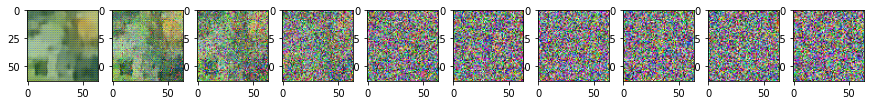

Epoch 210 | step 010 Loss: 0.16417133808135986 


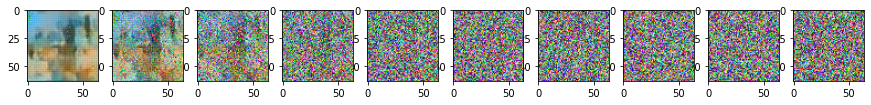

Epoch 215 | step 010 Loss: 0.14095185697078705 


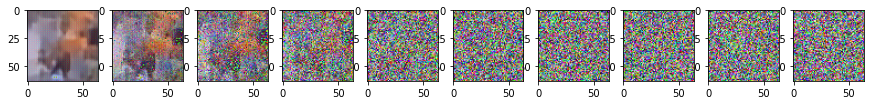

Epoch 220 | step 010 Loss: 0.15642337501049042 


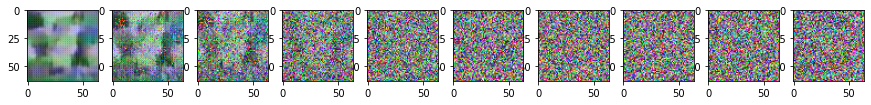

Epoch 225 | step 010 Loss: 0.14680105447769165 


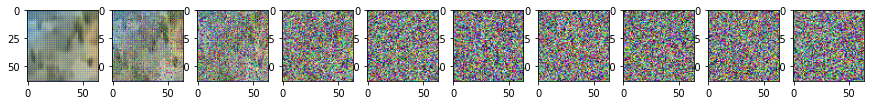

Epoch 230 | step 010 Loss: 0.1717510223388672 


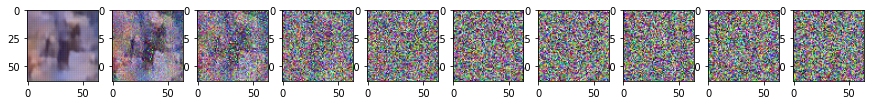

Epoch 235 | step 010 Loss: 0.1474859118461609 


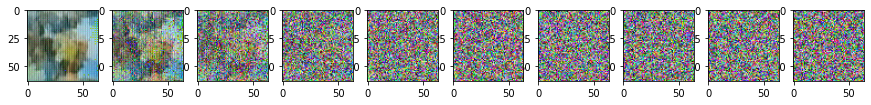

Epoch 240 | step 010 Loss: 0.14739803969860077 


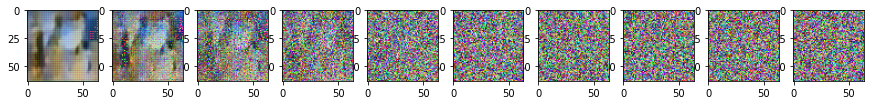

Epoch 245 | step 010 Loss: 0.16119222342967987 


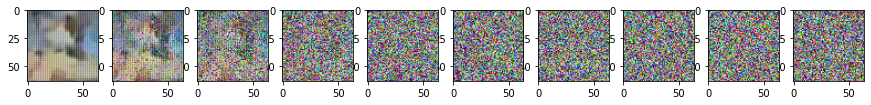

Epoch 250 | step 010 Loss: 0.1533670872449875 


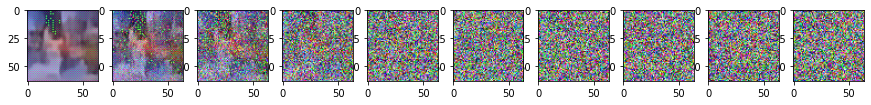

Epoch 255 | step 010 Loss: 0.14844980835914612 


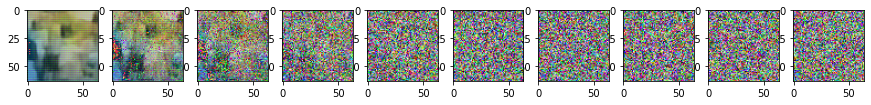

Epoch 260 | step 010 Loss: 0.1692090630531311 


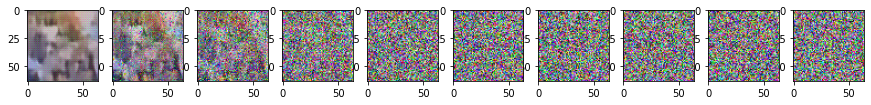

Epoch 265 | step 010 Loss: 0.1549948900938034 


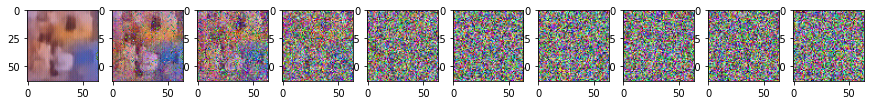

Epoch 270 | step 010 Loss: 0.17130284011363983 


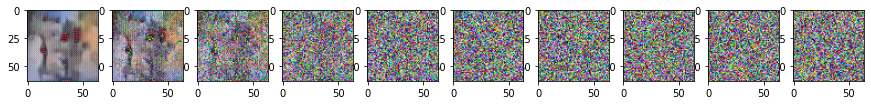

Epoch 275 | step 010 Loss: 0.1533975750207901 


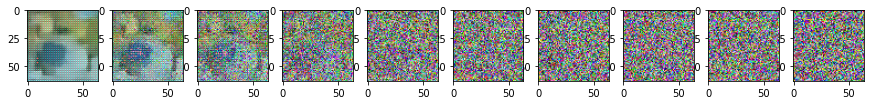

Epoch 280 | step 010 Loss: 0.14365741610527039 


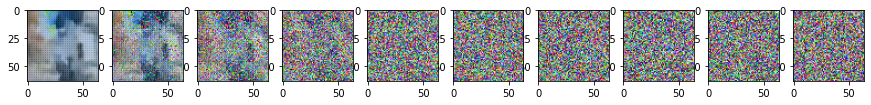

Epoch 285 | step 010 Loss: 0.14721712470054626 


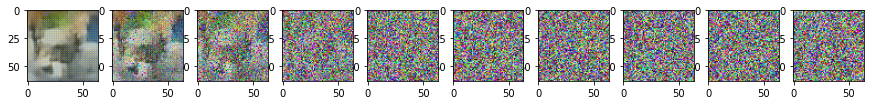

Epoch 290 | step 010 Loss: 0.16343870759010315 


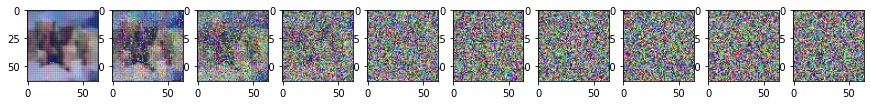

Epoch 295 | step 010 Loss: 0.13994476199150085 


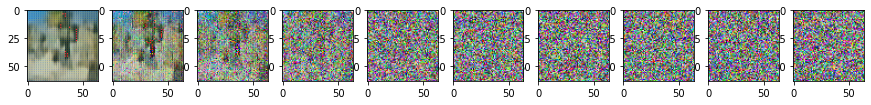

Epoch 300 | step 010 Loss: 0.1535632461309433 


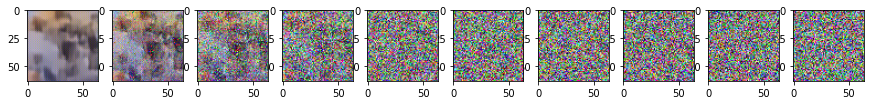

Epoch 305 | step 010 Loss: 0.13550066947937012 


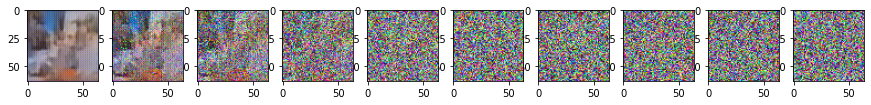

Epoch 310 | step 010 Loss: 0.14661183953285217 


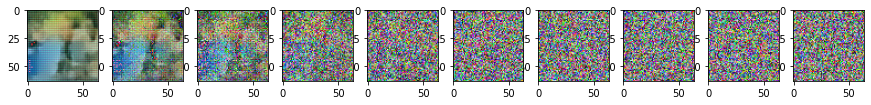

Epoch 315 | step 010 Loss: 0.1405482143163681 


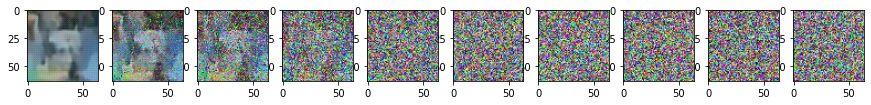

Epoch 320 | step 010 Loss: 0.14624080061912537 


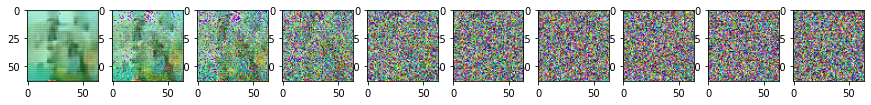

Epoch 325 | step 010 Loss: 0.1582147479057312 


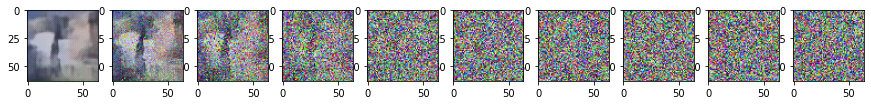

Epoch 330 | step 010 Loss: 0.14821156859397888 


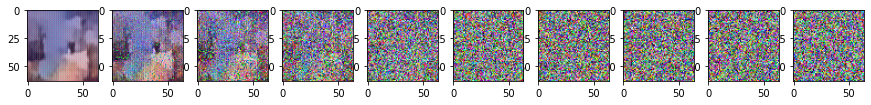

Epoch 335 | step 010 Loss: 0.14816567301750183 


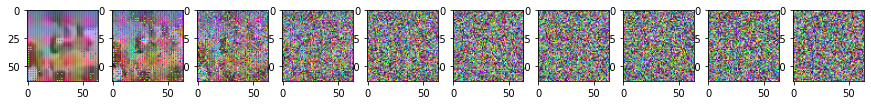

Epoch 340 | step 010 Loss: 0.13593973219394684 


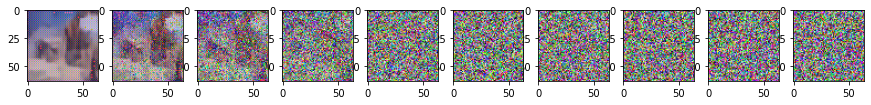

Epoch 345 | step 010 Loss: 0.14358407258987427 


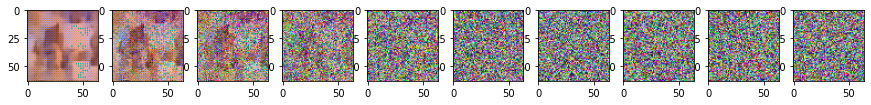

Epoch 350 | step 010 Loss: 0.14228132367134094 


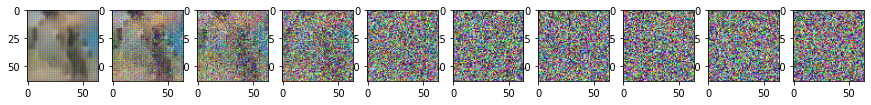

Epoch 355 | step 010 Loss: 0.15811732411384583 


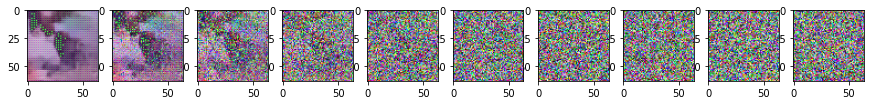

Epoch 360 | step 010 Loss: 0.13515523076057434 


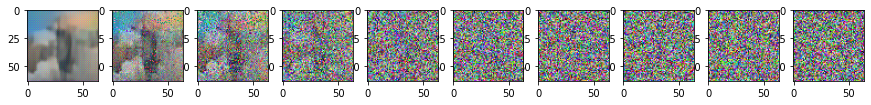

Epoch 365 | step 010 Loss: 0.1333419382572174 


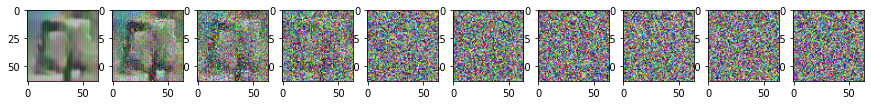

Epoch 370 | step 010 Loss: 0.1390000283718109 


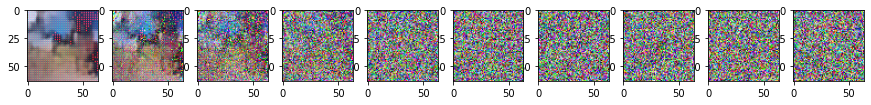

Epoch 375 | step 010 Loss: 0.14190956950187683 


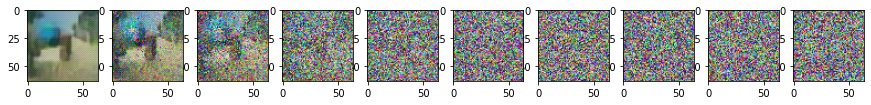

Epoch 380 | step 010 Loss: 0.1464390903711319 


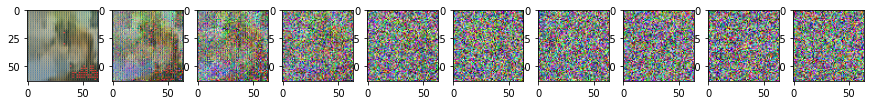

Epoch 385 | step 010 Loss: 0.15437501668930054 


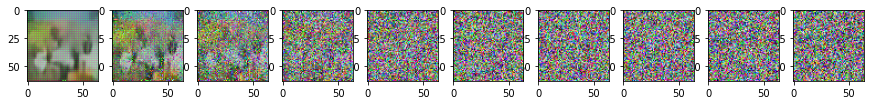

Epoch 390 | step 010 Loss: 0.1388101577758789 


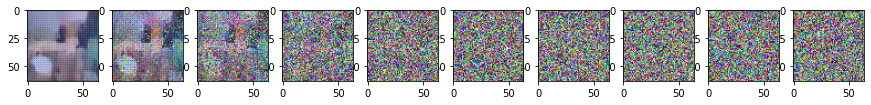

Epoch 395 | step 010 Loss: 0.1309824138879776 


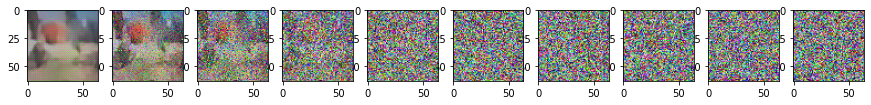

Epoch 400 | step 010 Loss: 0.14257584512233734 


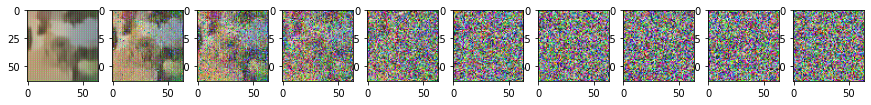

Epoch 405 | step 010 Loss: 0.15580438077449799 


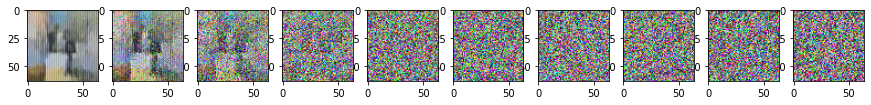

Epoch 410 | step 010 Loss: 0.13408493995666504 


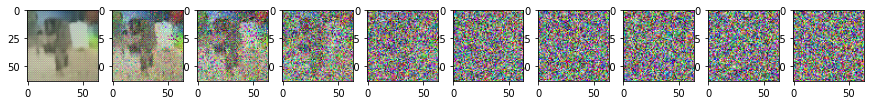

Epoch 415 | step 010 Loss: 0.14333288371562958 


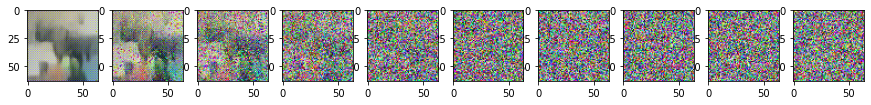

Epoch 420 | step 010 Loss: 0.14683318138122559 


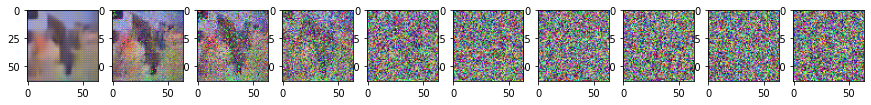

Epoch 425 | step 010 Loss: 0.16167737543582916 


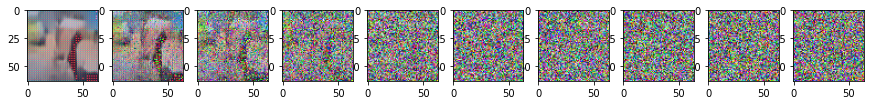

Epoch 430 | step 010 Loss: 0.14713206887245178 


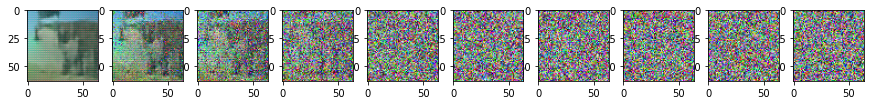

Epoch 435 | step 010 Loss: 0.14452728629112244 


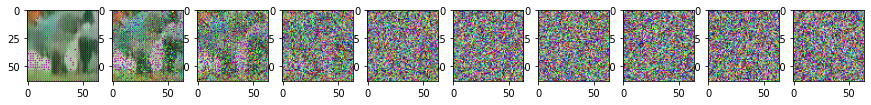

Epoch 440 | step 010 Loss: 0.14748869836330414 


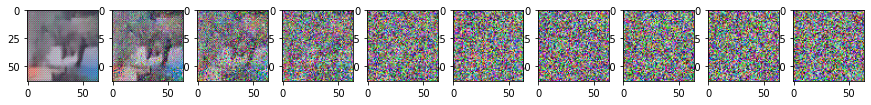

Epoch 445 | step 010 Loss: 0.14796799421310425 


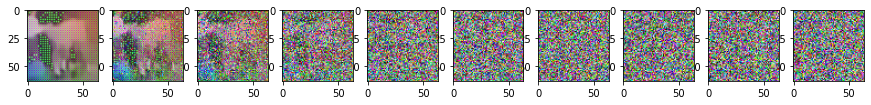

Epoch 450 | step 010 Loss: 0.15727828443050385 


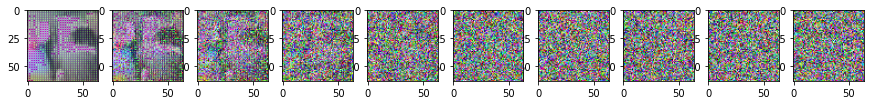

Epoch 455 | step 010 Loss: 0.1679002046585083 


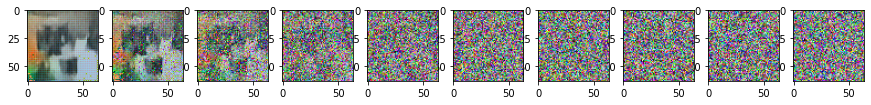

Epoch 460 | step 010 Loss: 0.14319519698619843 


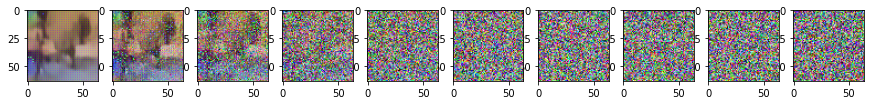

Epoch 465 | step 010 Loss: 0.134568452835083 


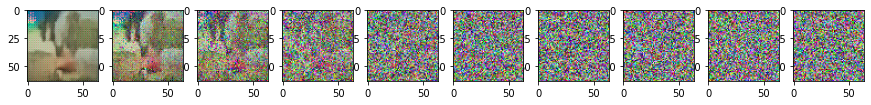

Epoch 470 | step 010 Loss: 0.13379812240600586 


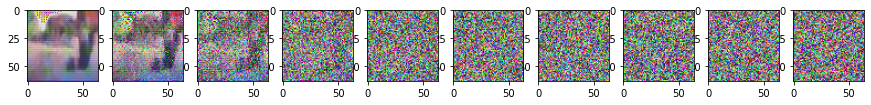

Epoch 475 | step 010 Loss: 0.13924741744995117 


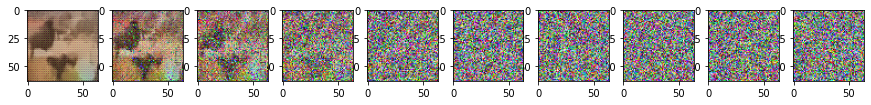

Epoch 480 | step 010 Loss: 0.15810075402259827 


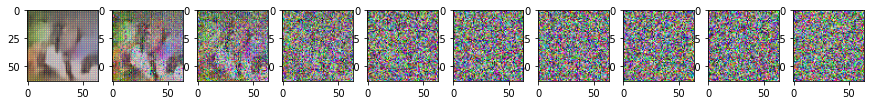

Epoch 485 | step 010 Loss: 0.13594111800193787 


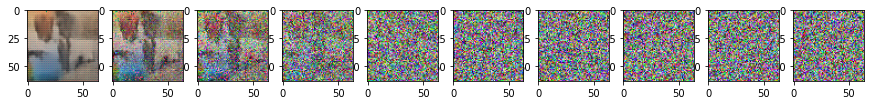

Epoch 490 | step 010 Loss: 0.14889349043369293 


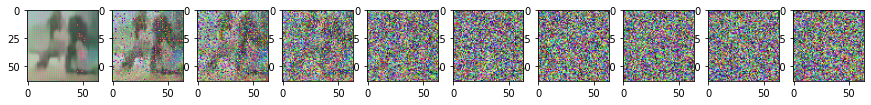

Epoch 495 | step 010 Loss: 0.1380406618118286 


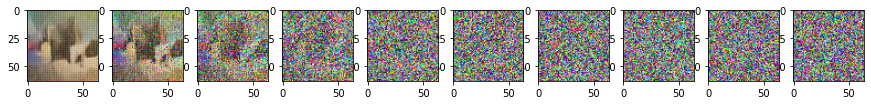

In [11]:
from torch.optim import Adam

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)
optimizer = Adam(model.parameters(), lr=0.001)
epochs = 500 # Try more!

for epoch in range(epochs):
    for step, batch in enumerate(dataloader):
        optimizer.zero_grad()
        t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
        loss = get_loss(model, batch, t)
        loss.backward()
        optimizer.step()
    if epoch % 5 == 0:
        print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
        sample_plot_image()
        torch.save(model.state_dict(), './model_%d_500epochs_linearschedule.pth'%epoch)

In Table 2, we show the sample quality effects of reverse process parameterizations and training
objectives (Section 3.2). We find that the baseline option of predicting µ˜ works well only when
trained on the true variational bound instead of unweighted mean squared error, a simplified objective
akin to Eq. (14). We also see that learning reverse process variances (by incorporating a parameterized
diagonal Σθ(xt) into the variational bound) leads to unstable training and poorer sample quality
compared to fixed variances. Predicting , as we proposed, performs approximately as well as
predicting µ˜ when trained on the variational bound with fixed variances, but much better when trained
with our simplified objective.


iffusion models scale down the data with each forward process step (by a √
1 − βt factor)
so that variance does not grow when adding noise, thus providing consistently scaled inputs
to the neural net reverse process. NCSN omits this scaling factor.


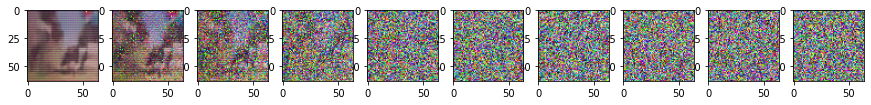

In [12]:
sample_plot_image()

In [13]:
torch.save(model.state_dict(), 'save/to/path/model_500epochs_linearschedule.pth')

RuntimeError: Parent directory save/to/path does not exist.